[View in Colaboratory](https://colab.research.google.com/github/mariagumbao/hello-world/blob/master/Decision_trees_and_resampling.ipynb)

<h1> RESAMPLING </h1>

Comparision of decision trees generated from data after resampling with three different resampling algorithms

- Oversampling: 
  - SMOTE: Connects inliers and outliers.
  - ADASYN: Focus solely in outliers.
- Undersampling: Instance hardness threshold: Samplest with lower probabilities are removed.

In [60]:
# Cargar datos

from google.colab import files
files.upload()

Saving datosConversionAcmeActualizadosB.csv to datosConversionAcmeActualizadosB (1).csv


{u'datosConversionAcmeActualizadosB.csv': 'id,VecesEmpresaMedios1,VecesEmpresaMedios2,VecesSite1,VecesSite2,VecesSite3,VecesSite4,VecesSite5,VecesSite6,VecesSite7,VecesConversion,ConversionTemperature,prediction\n01461284375155348212620070628042822730,0,0,0,0,0,0,0,0,0,1,Very Cold,0\n03467214944450811191320811886926038553,0,0,0,0,0,0,0,0,0,1,Very Cold,0\n05709078073785905043398129890267964754,0,0,0,0,1,0,0,0,0,1,Very Cold,0\n08683640262926757533565319144165807273,0,0,0,0,0,0,0,0,0,1,Very Cold,0\n09897610196333312670654750440933914957,0,0,0,0,0,0,0,0,0,1,Very Cold,0\n12177177289504151554665609240421027091,0,0,0,0,0,0,0,0,0,1,Very Cold,0\n13689490612611508854246583524779268544,0,0,0,0,0,0,0,0,0,1,Very Cold,0\n14807922933056334862173884359681909236,0,0,0,0,0,0,0,0,0,1,Very Cold,0\n22174643794680388390951845044181892665,0,0,0,0,0,0,0,0,0,1,Very Cold,0\n22183310872540159543212491819830097741,0,0,0,0,0,0,0,0,0,1,Very Cold,0\n26670235180892352811320502171499804785,0,0,0,0,0,0,0,0,0,1,Very Col

In [0]:
# Data
import pandas as pd
data = pd.read_csv('datosConversionAcmeActualizadosB.csv')
X = data.drop(columns=['id','VecesConversion','ConversionTemperature','prediction']).astype(dtype='int')
y = data['VecesConversion'].astype(dtype='int')

In [90]:
# Checking the stats
print('{:3.2f}% converted'.format(sum(y)*100./len(y)))

1.69% converted


In [0]:
# Transforming in categorical data -> One Hot Encoder
#
#from sklearn.preprocessing import OneHotEncoder
#
#one_hot = OneHotEncoder()
#one_hot.fit(X)
#print(one_hot.n_values_)
#print(one_hot.feature_indices_)
#X_one_hot = one_hot.transform(X).toarray()

In [92]:
#!pip install imblearn

# Resampling
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import ADASYN
from imblearn.under_sampling import InstanceHardnessThreshold

# Resampled data
X_resampled_SMOTE,     y_resampled_SMOTE     = SMOTE().fit_sample(X,y)
X_resampled_ADASYN,    y_resampled_ADASYN    = ADASYN().fit_sample(X,y)
X_resampled_Threshold, y_resampled_Threshold = InstanceHardnessThreshold().fit_sample(X,y)

# New stats
print('New stats (SMOTE):     {:3.2f}% converted'.format(sum(y_resampled_SMOTE)*100./len(y_resampled_SMOTE)))
print('New stats (ADASYN):    {:3.2f}% converted'.format(sum(y_resampled_ADASYN)*100./len(y_resampled_ADASYN)))
print('New stats (Threshold): {:3.2f}% converted'.format(sum(y_resampled_Threshold)*100./len(y_resampled_Threshold)))

New stats (SMOTE):     50.00% converted
New stats (ADASYN):    50.01% converted
New stats (Threshold): 8.97% converted


<h2> _SMOTE algorithm_ </h2>

In [0]:
# Train - test splitting
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_resampled_SMOTE, y_resampled_SMOTE, test_size = 0.33)

In [0]:
# Choosing the best parameters for the model
from sklearn.tree            import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

tree = DecisionTreeClassifier(min_samples_leaf = 50, min_samples_split = 100)
parameters = {'max_depth': range(1,5)}
tree = GridSearchCV(tree, parameters, cv=5)

In [95]:
# Creating the actual model

tree.fit(X_train, y_train)
y_tree = tree.predict(X_test)

from sklearn.metrics import mean_absolute_error
mae = mean_absolute_error(y_tree, y_test)
print('Score: {:4.2f}'.format(1 - mae))

Score: 0.84


In [96]:
from sklearn.tree import _tree

def tree_to_code(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]
    print "def tree({}):".format(", ".join(feature_names))

    def recurse(node, depth):
        indent = "  " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            print "{}if {} <= {}:".format(indent, name, threshold)
            recurse(tree_.children_left[node], depth + 1)
            print "{}else:  # if {} > {}".format(indent, name, threshold)
            recurse(tree_.children_right[node], depth + 1)
        else:
            print "{}return {}".format(indent, tree_.value[node])

    recurse(0, 1)
    
    
tree_to_code(tree.best_estimator_, X.columns)

def tree(VecesEmpresaMedios1, VecesEmpresaMedios2, VecesSite1, VecesSite2, VecesSite3, VecesSite4, VecesSite5, VecesSite6, VecesSite7):
  if VecesSite3 <= 0.999118626118:
    if VecesEmpresaMedios1 <= 0.997581005096:
      if VecesSite7 <= 0.999952912331:
        if VecesSite2 <= 0.99926173687:
          return [[ 61887. 216125.]]
        else:  # if VecesSite2 > 0.99926173687
          return [[28863.  1148.]]
      else:  # if VecesSite7 > 0.999952912331
        if VecesSite5 <= 0.00089398905402:
          return [[36570.  1954.]]
        else:  # if VecesSite5 > 0.00089398905402
          return [[  0. 310.]]
    else:  # if VecesEmpresaMedios1 > 0.997581005096
      if VecesEmpresaMedios1 <= 2.00088500977:
        if VecesSite7 <= 0.000284696201561:
          return [[43893.  3456.]]
        else:  # if VecesSite7 > 0.000284696201561
          return [[  0. 137.]]
      else:  # if VecesEmpresaMedios1 > 2.00088500977
        if VecesEmpresaMedios1 <= 8.01101303101:
          return

In [97]:
# Predicting without the resampling
y_SMOTE = tree.predict(X)
mae = mean_absolute_error(y_SMOTE,y)

print('Score with original data: {:4.2f}'.format(1-mae))

Score with original data: 0.73


<h2>_ADASYN_</h2>

In [0]:
# Train - test splitting
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_resampled_ADASYN, y_resampled_ADASYN, test_size = 0.33)

In [0]:
# Choosing the best parameters for the model
from sklearn.tree            import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

tree = DecisionTreeClassifier(min_samples_leaf = 50, min_samples_split=100)
parameters = {'max_depth': range(1,5)}
tree = GridSearchCV(tree, parameters, cv=5)

In [100]:
# Creating the actual model

tree.fit(X_train, y_train)
y_tree = tree.predict(X_test)

from sklearn.metrics import mean_absolute_error
mae = mean_absolute_error(y_tree, y_test)
print('Score: {:4.2f}'.format(1 - mae))

Score: 0.71


In [101]:
from sklearn.tree import _tree

def tree_to_code(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]
    print "def tree({}):".format(", ".join(feature_names))

    def recurse(node, depth):
        indent = "  " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            print "{}if {} <= {}:".format(indent, name, threshold)
            recurse(tree_.children_left[node], depth + 1)
            print "{}else:  # if {} > {}".format(indent, name, threshold)
            recurse(tree_.children_right[node], depth + 1)
        else:
            print "{}return {}".format(indent, tree_.value[node])

    recurse(0, 1)
    
    
tree_to_code(tree.best_estimator_, X.columns)

def tree(VecesEmpresaMedios1, VecesEmpresaMedios2, VecesSite1, VecesSite2, VecesSite3, VecesSite4, VecesSite5, VecesSite6, VecesSite7):
  if VecesEmpresaMedios1 <= 9.41300604609e-05:
    if VecesSite7 <= 3.67987813661e-05:
      if VecesSite5 <= 0.00556299975142:
        if VecesSite3 <= 0.00119992159307:
          return [[67115. 10919.]]
        else:  # if VecesSite3 > 0.00119992159307
          return [[43898. 18599.]]
      else:  # if VecesSite5 > 0.00556299975142
        if VecesSite2 <= 0.000161150834174:
          return [[23587. 11231.]]
        else:  # if VecesSite2 > 0.000161150834174
          return [[   0. 2732.]]
    else:  # if VecesSite7 > 3.67987813661e-05
      if VecesSite5 <= 0.00371286994778:
        if VecesSite2 <= 0.000346059590811:
          return [[36537. 33349.]]
        else:  # if VecesSite2 > 0.000346059590811
          return [[   0. 4374.]]
      else:  # if VecesSite5 > 0.00371286994778
        return [[   0. 6889.]]
  else:  # if VecesEmpresaMedios

In [102]:
# Predicting without the resampling
y_ADASYN = tree.predict(X)
mae = mean_absolute_error(y_ADASYN,y)

print('Score with original data: {:4.2f}'.format(1-mae))

Score with original data: 0.74


<h2>_Threshold_</h2>

In [0]:
# Train - test splitting
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_resampled_Threshold, y_resampled_Threshold, test_size = 0.33)

In [0]:
# Choosing the best parameters for the model
from sklearn.tree            import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

tree = DecisionTreeClassifier(min_samples_leaf = 50, min_samples_split=100)
parameters = {'max_depth': range(1,5)}
tree = GridSearchCV(tree, parameters, cv=5)

In [105]:
# Creating the actual model

tree.fit(X_train, y_train)
y_tree = tree.predict(X_test)

from sklearn.metrics import mean_absolute_error
mae = mean_absolute_error(y_tree, y_test)
print('Score: {:4.2f}'.format(1 - mae))

Score: 0.91


In [106]:
from sklearn.tree import _tree

def tree_to_code(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]
    print "def tree({}):".format(", ".join(feature_names))

    def recurse(node, depth):
        indent = "  " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            print "{}if {} <= {}:".format(indent, name, threshold)
            recurse(tree_.children_left[node], depth + 1)
            print "{}else:  # if {} > {}".format(indent, name, threshold)
            recurse(tree_.children_right[node], depth + 1)
        else:
            print "{}return {}".format(indent, tree_.value[node])

    recurse(0, 1)
    
    
tree_to_code(tree.best_estimator_, X.columns)

def tree(VecesEmpresaMedios1, VecesEmpresaMedios2, VecesSite1, VecesSite2, VecesSite3, VecesSite4, VecesSite5, VecesSite6, VecesSite7):
  if VecesEmpresaMedios2 <= 0.5:
    return [[29539.  3952.]]
  else:  # if VecesEmpresaMedios2 > 0.5
    return [[1.0451e+04 1.0000e+00]]


In [107]:
# Predicting without the resampling
y_Threshold = tree.predict(X)
mae = mean_absolute_error(y_Threshold,y)

print('Score with original data: {:4.2f}'.format(1-mae))

Score with original data: 0.98


<h2>Visualization</h2>

In [0]:
import matplotlib.pyplot as plt

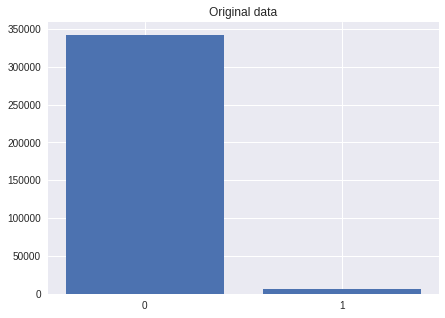

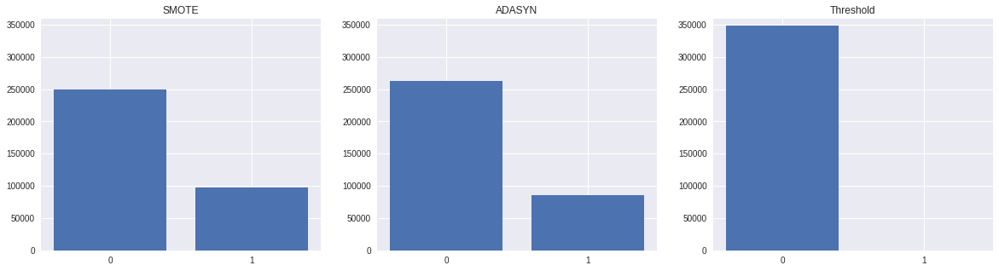

In [109]:
x = [0,1]

# ORIGINAL
plt.figure(figsize=(7,5))
height_original = [sum(y==x[0]), sum(y==x[1])]

plt.bar(x,height_original)
plt.title('Original data')
plt.xticks(x,['0','1'])
yLimits = plt.gca().get_ylim()

# -------------------------------

plt.figure(figsize=(20,5))
# SMOTE
plt.subplot(131)

height = [sum(y_SMOTE==x[0]), sum(y_SMOTE==x[1])]
plt.bar(x, height)
plt.title('SMOTE')
plt.xticks(x,['0','1'])
plt.ylim(yLimits)

# ADASYN
plt.subplot(132)

height = [sum(y_ADASYN==x[0]), sum(y_ADASYN==x[1])]
plt.bar(x, height)
plt.title('ADASYN')
plt.xticks(x,['0','1'])
plt.ylim(yLimits)

# Threshold
plt.subplot(133)

height = [sum(y_Threshold==x[0]), sum(y_Threshold==x[1])]
plt.bar(x, height)
plt.title('Threshold')
plt.xticks(x,['0','1'])
plt.ylim(yLimits)


plt.show()

In [110]:
# Matriz the confusión

from sklearn.metrics import confusion_matrix

matrix_SMOTE = confusion_matrix(y, y_SMOTE)
matrix_ADASYN = confusion_matrix(y, y_ADASYN)
matrix_Threshold = confusion_matrix(y, y_Threshold)

print('Confusion matrix')
print('----------------')

print('SMOTE')
print(matrix_SMOTE)

print('\nADSYN')
print(matrix_ADASYN)

print('\nThreshold')
print(matrix_Threshold)

Confusion matrix
----------------
SMOTE
[[249550  92336]
 [   305   5581]]

ADSYN
[[256344  85542]
 [  5662    224]]

Threshold
[[341886      0]
 [  5886      0]]


In [111]:
# Area under ROC curve

from sklearn.metrics import roc_auc_score

roc_auc_SMOTE = roc_auc_score(y, y_SMOTE)
roc_auc_ADASYN = roc_auc_score(y, y_ADASYN)
roc_auc_Threshold = roc_auc_score(y, y_Threshold)

print('Area under the ROC curve')
print('------------------------')

print('SMOTE')
print(roc_auc_SMOTE)

print('\nADSYN')
print(roc_auc_ADASYN)

print('\nThreshold')
print(roc_auc_Threshold)

Area under the ROC curve
------------------------
SMOTE
0.8390518984387872

ADSYN
0.3939250979708212

Threshold
0.5


<h2> Updating the dataset </h2>

In [0]:
dataSMOTE     = pd.DataFrame({'prediction_SMOTE': y_SMOTE})
dataADASYN    = pd.DataFrame({'prediction_ADASYN': y_ADASYN})
dataThreshold = pd.DataFrame({'prediction_Threshold': y_Threshold})

In [0]:
data = pd.concat([data,dataSMOTE], axis=1)
data = pd.concat([data,dataADASYN], axis=1)
data = pd.concat([data,dataThreshold], axis=1)

In [114]:
# Checking if everything looks good
data.loc[:5]

,id,VecesEmpresaMedios1,VecesEmpresaMedios2,VecesSite1,VecesSite2,VecesSite3,VecesSite4,VecesSite5,VecesSite6,VecesSite7,VecesConversion,ConversionTemperature,prediction,prediction_SMOTE,prediction_ADASYN,prediction_Threshold
0,01461284375155348212620070628042822730,0,0,0,0,0,0,0,0,0,1,Very Cold,0,1,0,0
1,03467214944450811191320811886926038553,0,0,0,0,0,0,0,0,0,1,Very Cold,0,1,0,0
2,05709078073785905043398129890267964754,0,0,0,0,1,0,0,0,0,1,Very Cold,0,0,0,0
3,08683640262926757533565319144165807273,0,0,0,0,0,0,0,0,0,1,Very Cold,0,1,0,0
4,09897610196333312670654750440933914957,0,0,0,0,0,0,0,0,0,1,Very Cold,0,1,0,0
5,12177177289504151554665609240421027091,0,0,0,0,0,0,0,0,0,1,Very Cold,0,1,0,0


In [0]:
from google.colab import files
#files.download(data.to_csv('datosConversionAcmeResampling.csv'))